# Image Matching Challenge 2024  

## Importing Libraries

In [1]:
import os
from pathlib import Path

import cv2
import mediapy
import pandas as pd
import numpy as np

import pycolmap
import plotly.express as px

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_exhaustive
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

## Data

In [2]:
root_dir = Path("/mnt/d/Projects_D/Image_Matching_Challenge_2024/")
root_dir

PosixPath('/mnt/d/Projects_D/Image_Matching_Challenge_2024')

In [3]:
data_dir = Path(root_dir, "data/image-matching-challenge-2024/")
data_dir

PosixPath('/mnt/d/Projects_D/Image_Matching_Challenge_2024/data/image-matching-challenge-2024')

## Train Data

In [4]:
train_data = pd.read_csv(data_dir / "train/train_labels.csv")

In [5]:
train_categories = pd.read_csv(data_dir / "train/categories.csv")

## Data Analysis

### Train Data

In [6]:
train_data.head()

,image_name,rotation_matrix,translation_vector,calibration_matrix,dataset,scene
0,00.png,0.999017467386748;-0.01951432487219089;0.03979...,-0.011700149127917355;0.018812528601332625;0.3...,5809.066058292364;0.0;2496.9582994472266;0.0;5...,transp_obj_glass_cup,transp_obj_glass_cup
1,01.png,0.999147719991382;-0.021624129414769648;0.0351...,-0.011610785964818585;0.016710808069866724;0.3...,5809.066058292364;0.0;2496.9582994472266;0.0;5...,transp_obj_glass_cup,transp_obj_glass_cup
2,02.png,0.9992527616183833;-0.02402019259931326;0.0302...,-0.011589797430545654;0.014113680489915202;0.3...,5809.066058292364;0.0;2496.9582994472266;0.0;5...,transp_obj_glass_cup,transp_obj_glass_cup
3,03.png,0.9993946226667176;-0.02356062921667625;0.0255...,-0.011471598819000773;0.011325953000912126;0.3...,5809.066058292364;0.0;2496.9582994472266;0.0;5...,transp_obj_glass_cup,transp_obj_glass_cup
4,04.png,0.9995276708105233;-0.02256816267742356;0.0208...,-0.011389007765655301;0.008237801582322509;0.3...,5809.066058292364;0.0;2496.9582994472266;0.0;5...,transp_obj_glass_cup,transp_obj_glass_cup


In [7]:
train_data.groupby("dataset")["scene"].nunique()

dataset
church                              1
dioscuri                            1
lizard                              1
multi-temporal-temple-baalshamin    1
pond                                1
transp_obj_glass_cup                1
transp_obj_glass_cylinder           1
Name: scene, dtype: int64

In [8]:
# dataset distribution
dataset_counts = train_data["dataset"].value_counts()

fig = px.pie(values=dataset_counts.values, names=dataset_counts.index)
fig.update_traces(textposition='inside', textfont_size=14)
fig.update_layout(
    title={
        'text': "Pie distribution of dataset images",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend_title_text='Dataset names:'
)
fig.show()

### Train Categories

In [9]:
train_categories.head()

,scene,categories
0,church,symmetries-and-repeats
1,dioscuri,historical_preservation;air-to-ground
2,lizard,day-night;temporal
3,multi-temporal-temple-baalshamin,historical_preservation;temporal
4,pond,day-night;temporal;nature


In [10]:
train_categories["category"] = train_categories["categories"].str.split(";")
train_categories = train_categories.explode("category")

In [11]:
# category distribution
category_counts = train_categories["category"].value_counts()

fig = px.pie(values=category_counts.values, names=category_counts.index)
fig.update_traces(textposition='inside', textfont_size=14)
fig.update_layout(
    title={
        'text': "Pie distribution of categories",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    legend_title_text='Category names:'
)
fig.show()

### Relationship between dataset and categories

In [12]:
fig = px.sunburst(train_categories, path=['scene', 'category'])
fig.update_layout(
    title={
        'text': "Scene and category relation",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

fig.show()

## Exploring each dataset

In [13]:
def explore(split: str, dataset: str, plot_image_limit: int = 12) -> None:
    path = Path(data_dir / split / dataset)
    images_path = path / "images"
    smf_path = path / "smf"

    images = [cv2.cvtColor(cv2.imread(str(p)), cv2.COLOR_BGR2RGB) for p in list(images_path.glob("*"))[:plot_image_limit]]
    mediapy.show_images(images, height=300, columns=3)

    # if split != "test":
    #     rec_gt = pycolmap.Reconstruction(smf_path)
    # 
    #     fig = viz_3d.init_figure()
    #     viz_3d.plot_reconstruction(fig, rec_gt, cameras=False, color='rgba(227,168,30,0.5)', name="Ground Truth", cs=5)
    #     fig.show()

### Church

,,
,,
,,
,,

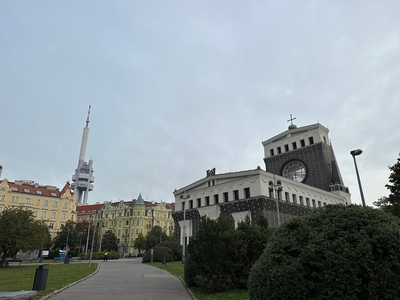
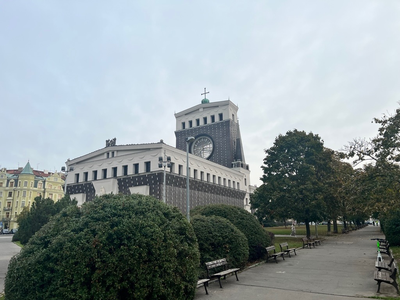
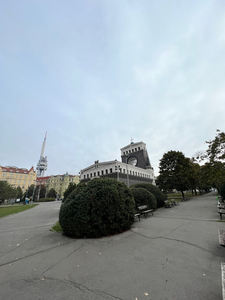
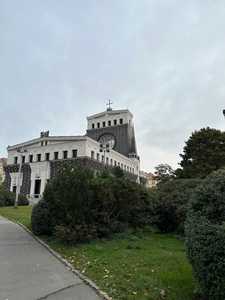
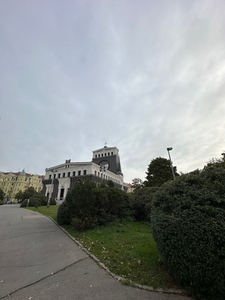
...
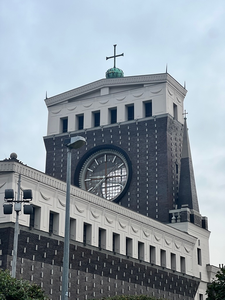
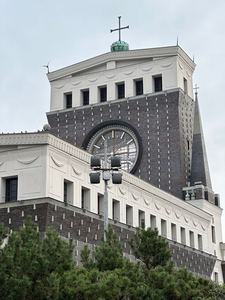
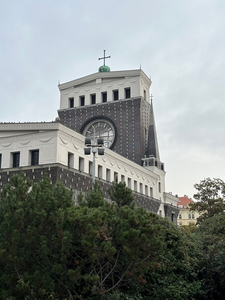
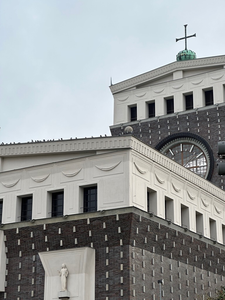
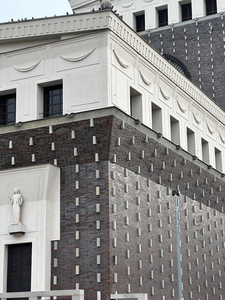

In [14]:
explore(split="train", dataset="church")

,,
,,
,,
,,

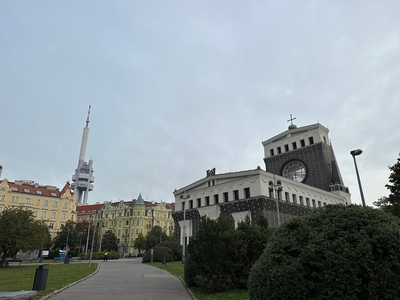
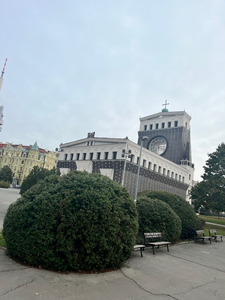
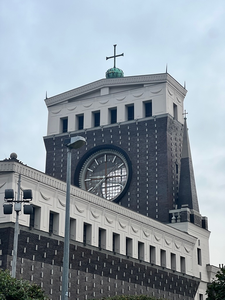
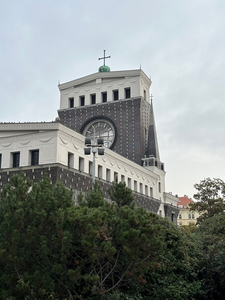
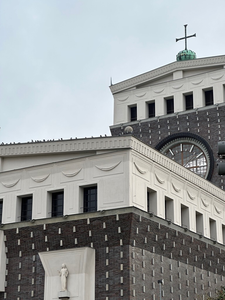
...
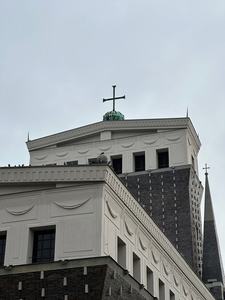
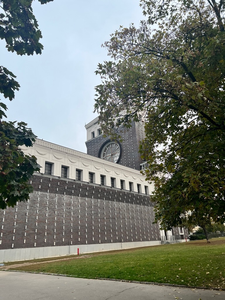
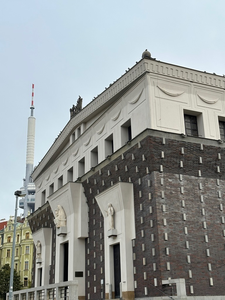
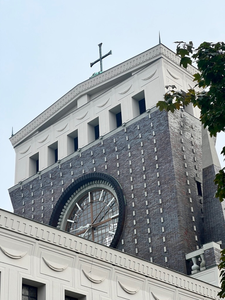
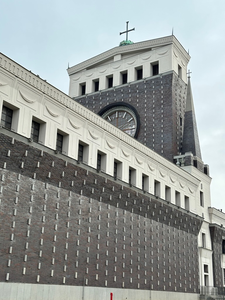

In [15]:
explore(split="test", dataset="church")

### Dioscuri

,,
,,
,,
,,

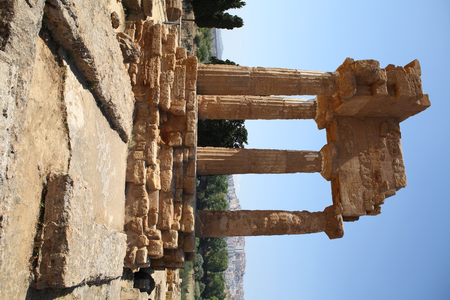
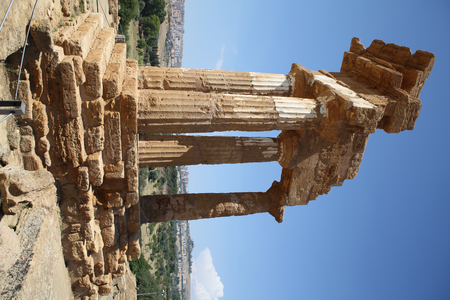
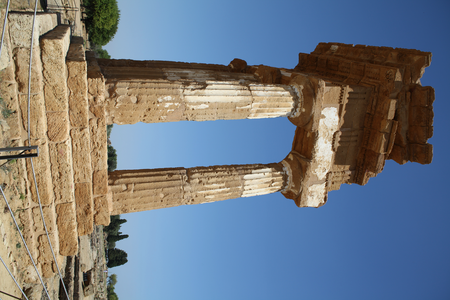
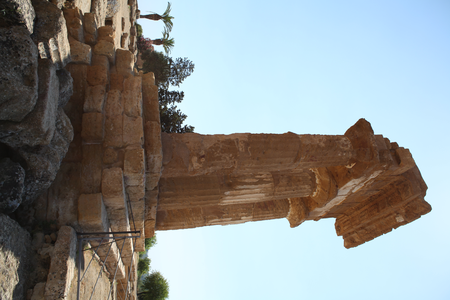
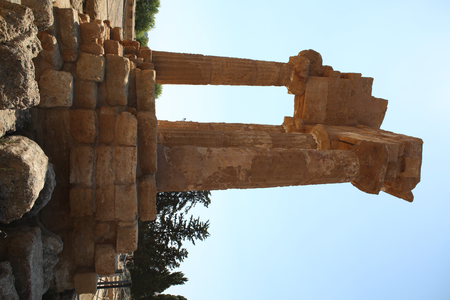
...
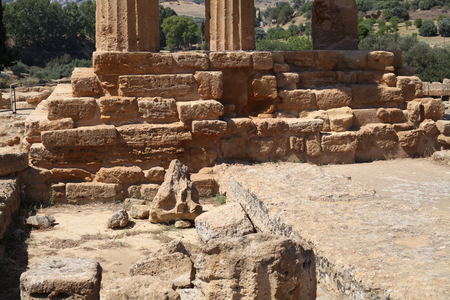
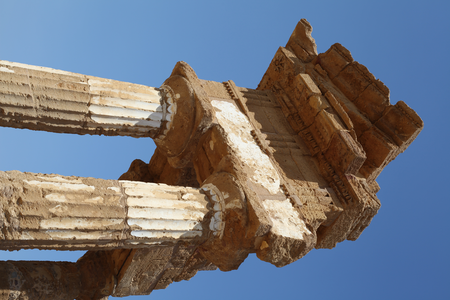
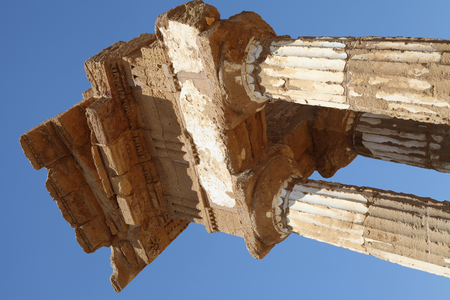
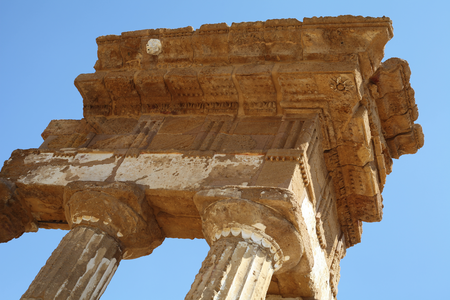
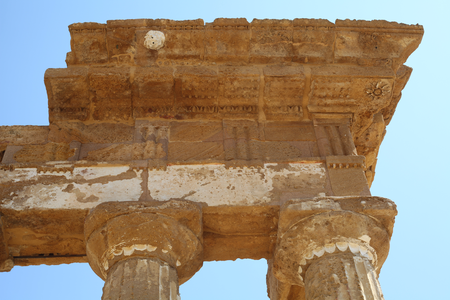

In [16]:
explore(split="train", dataset="dioscuri")

### Lizard

,,
,,
,,
,,

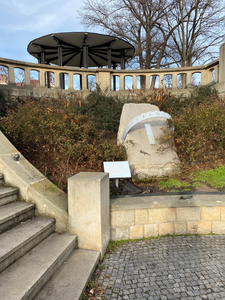
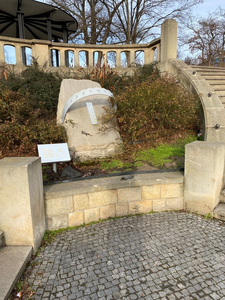
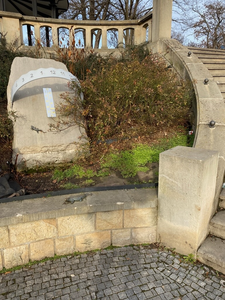
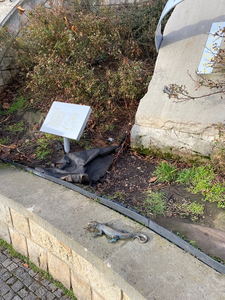
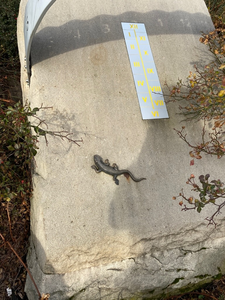
...
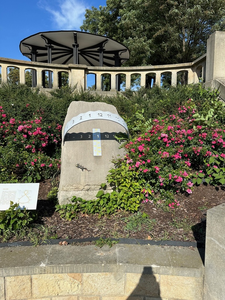
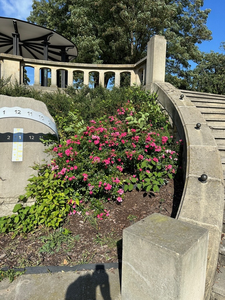
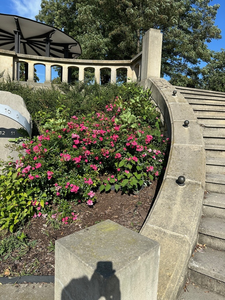
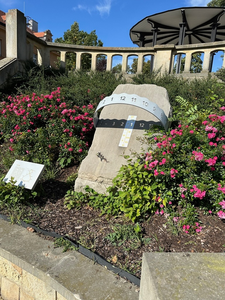
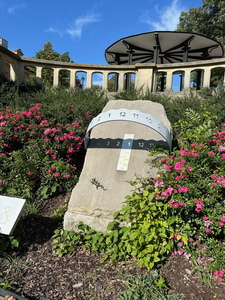

In [17]:
explore(split="train", dataset="lizard")

,,
,,
,,
,,

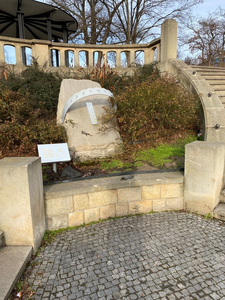
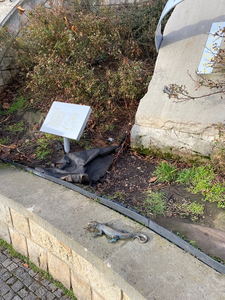
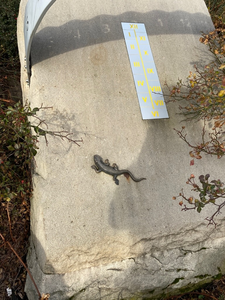
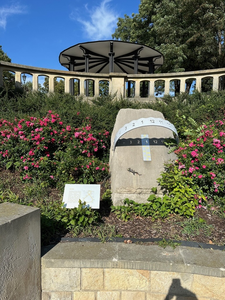
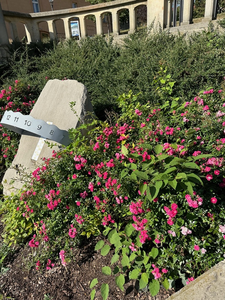
...
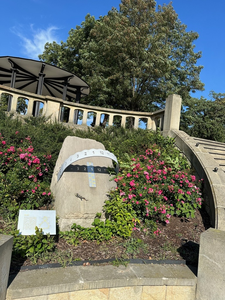
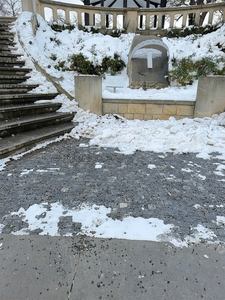
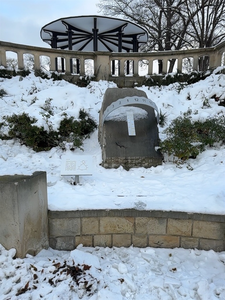
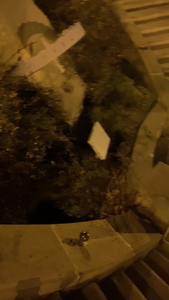
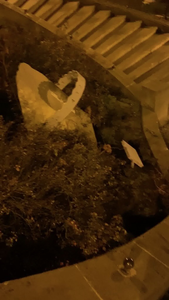

In [18]:
explore(split="test", dataset="lizard")

### The Temple of Baal-Shamin

,,
,,
,,
,,

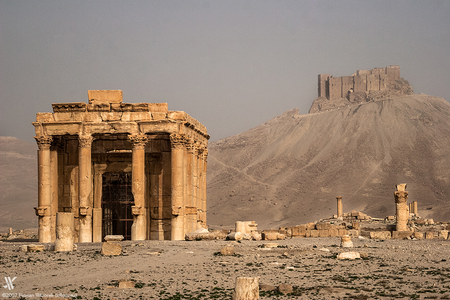
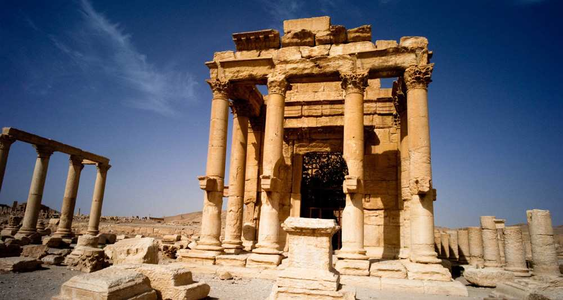
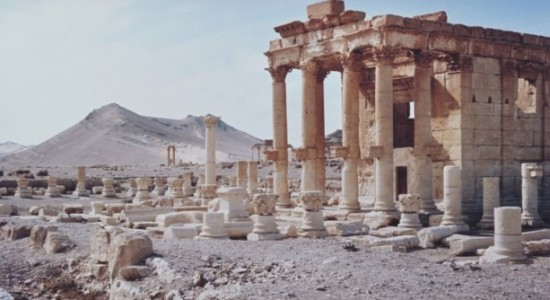
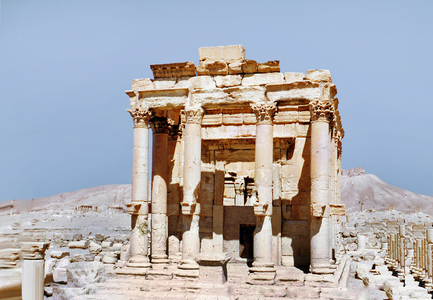
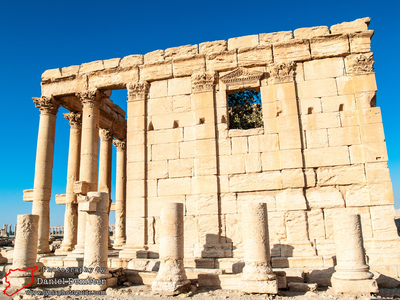
...
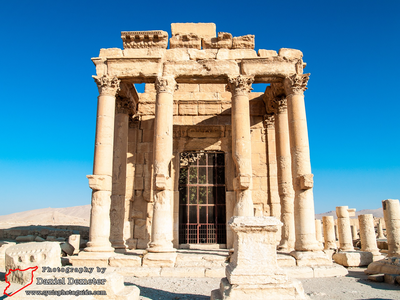
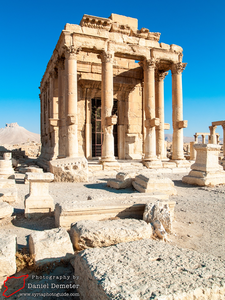
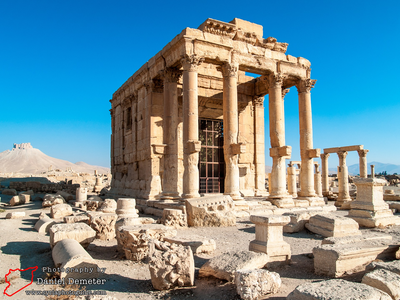
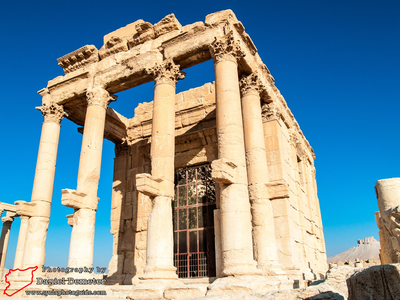
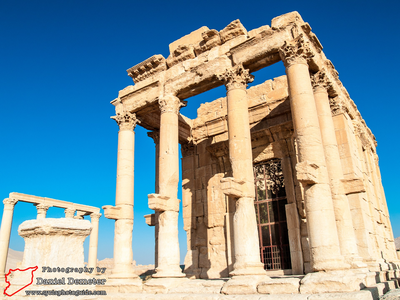

In [19]:
explore(split="train", dataset="multi-temporal-temple-baalshamin")

### Pond

,,
,,
,,
,,

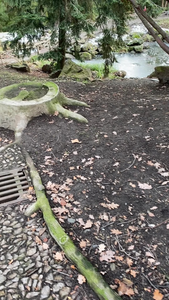
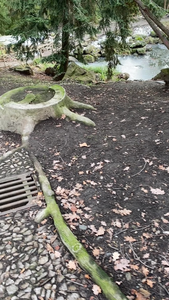
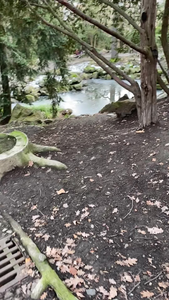
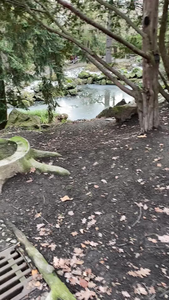
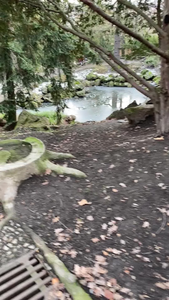
...
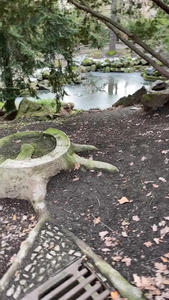
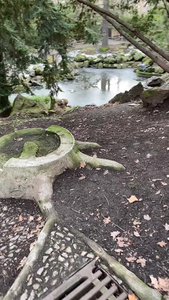
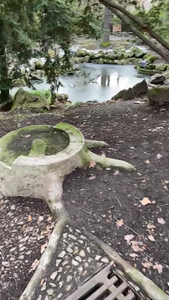
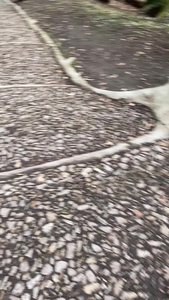
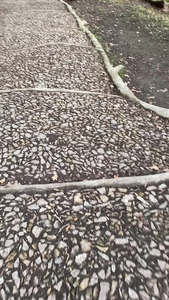

In [20]:
explore(split="train", dataset="pond")

### Glass Cup

,,
,,
,,
,,

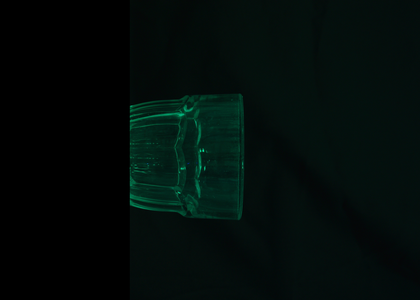
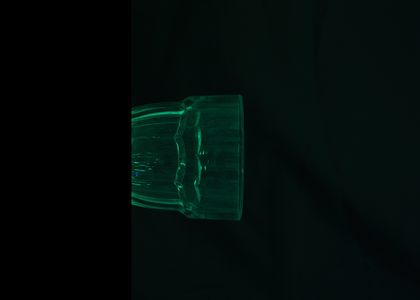
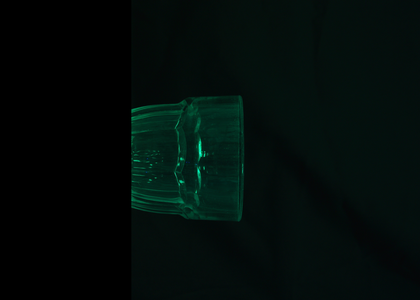
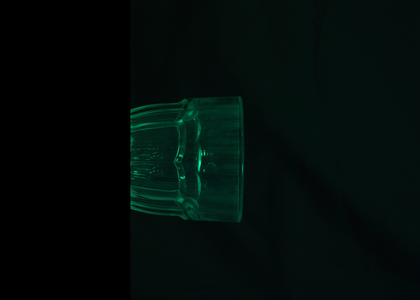
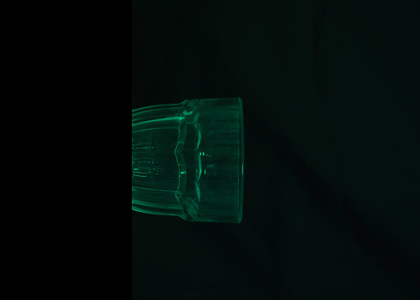
...
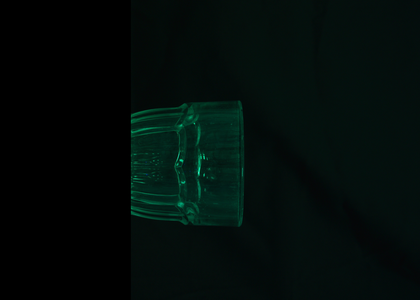
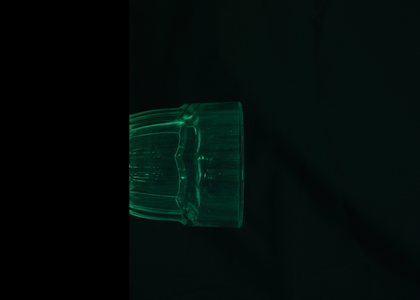
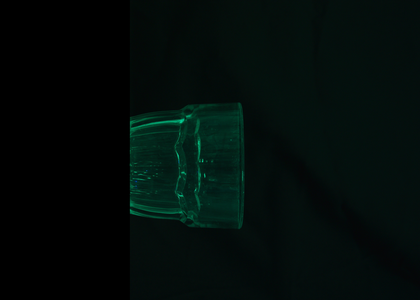
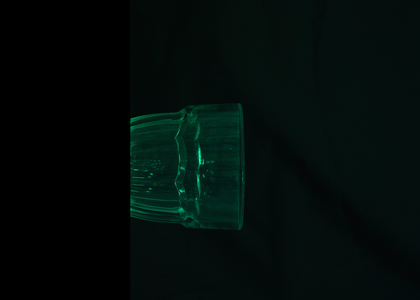
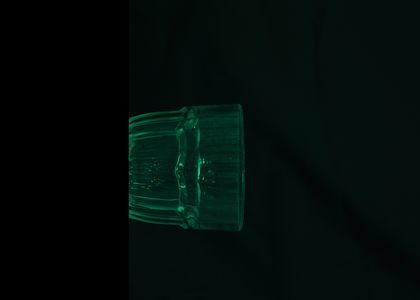

In [21]:
explore(split="train", dataset="transp_obj_glass_cup")

### Glass Cylinder

,,
,,
,,
,,

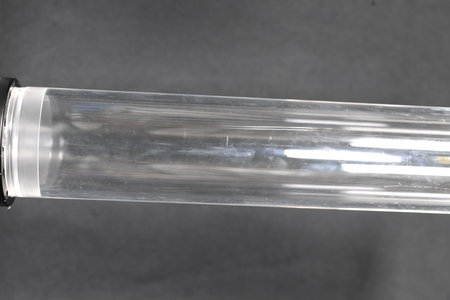
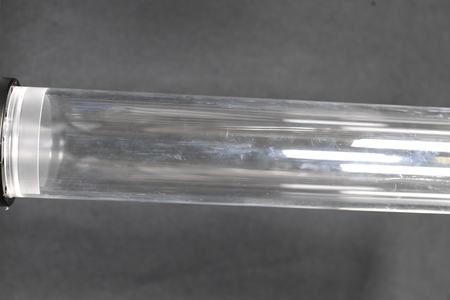
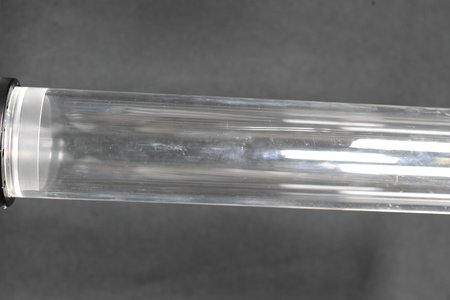
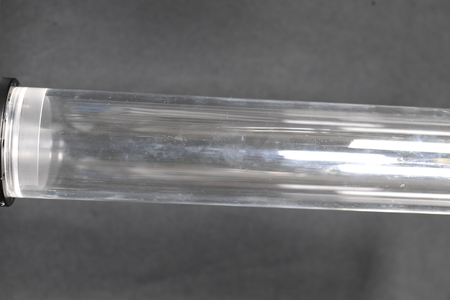
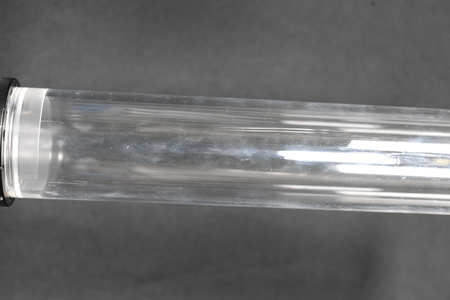
...
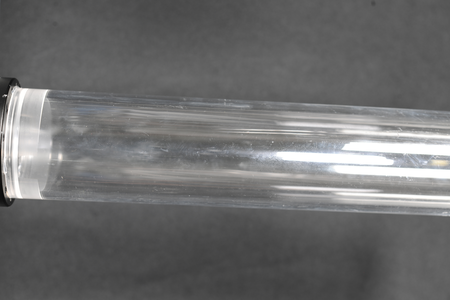
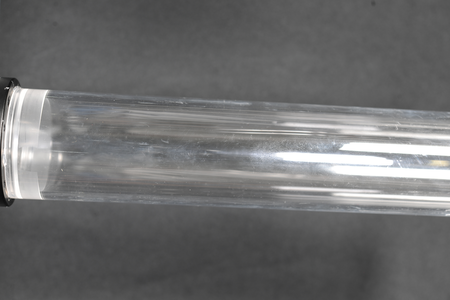
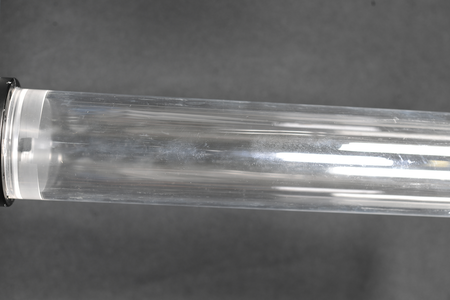
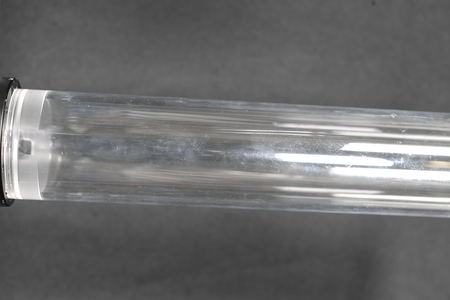
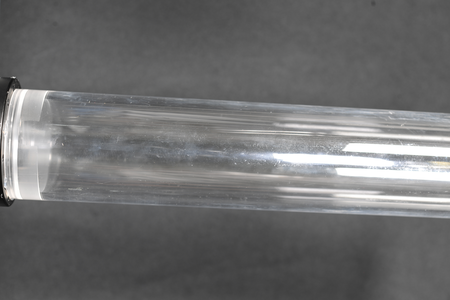

In [22]:
explore(split="train", dataset="transp_obj_glass_cylinder")